In [6]:
import os
import sys
sys.path.append('/root/capsule/code/beh_ephys_analysis')
import pandas as pd
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.patches as patches
import json
from harp.clock import decode_harp_clock, align_timestamps_to_anchor_points
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import re
from utils.beh_functions import parseSessionID, session_dirs, get_session_tbl
from utils.plot_utils import shiftedColorMap, template_reorder
from utils.ephys_functions import load_drift
from open_ephys.analysis import Session##
import spikeinterface as si
import spikeinterface.extractors as se
import spikeinterface.postprocessing as spost
import spikeinterface.widgets as sw
from aind_dynamic_foraging_basic_analysis.licks.lick_analysis import load_nwb
from aind_ephys_utils import align
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import colormaps
from aind_dynamic_foraging_data_utils.nwb_utils import load_nwb_from_filename
from spikeinterface.core.sorting_tools import random_spikes_selection
import pickle
import datetime
import spikeinterface.extractors as se
import spikeinterface.preprocessing as spre
import spikeinterface.postprocessing as spost
from tqdm import tqdm
import shutil
from utils.beh_functions import get_unit_tbl
from joblib import Parallel, delayed
%matplotlib inline

In [120]:
session = 'behavior_754897_2025-03-13_11-20-42'
data_type = 'curated'

In [121]:
session_dir = session_dirs(session)
sorting = si.load(session_dir[f'curated_dir_{data_type}'], load_extensions=False)
go_cue_raw_file = os.path.join(session_dir[f'ephys_dir_{data_type}'], 'gocue_raw_fake.zarr')
go_cue_bp_file = os.path.join(session_dir[f'ephys_dir_{data_type}'], 'gocue_bp.zarr')
all_raw_file = os.path.join(session_dir[f'ephys_dir_{data_type}'], 'raw_fake.zarr')
analyzer_all = si.load(session_dir[f'postprocessed_dir_{data_type}'], load_extensions=False)
analyzer_all_raw = si.load(all_raw_file, load_extensions=False)
analyzer_gocue_raw = si.load(go_cue_raw_file, load_extensions=False)
analyzer_gocue_bp = si.load(go_cue_bp_file, load_extensions=False)

In [123]:
units_focus = analyzer_gocue_bp.sorting.get_unit_ids()

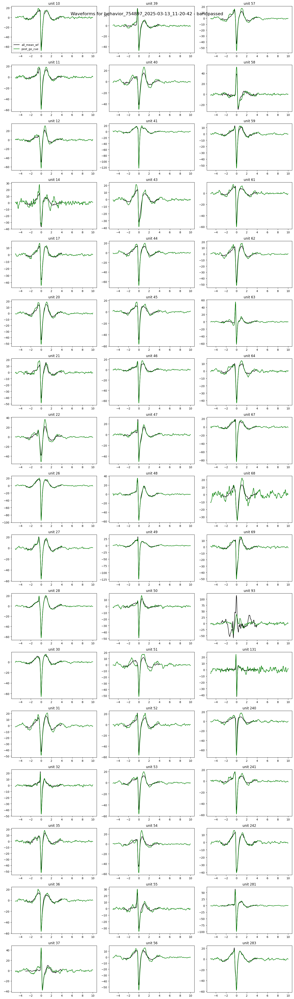

In [124]:
# loop through all unit_ids
# load wf from all three versions
fig = plt.figure(figsize=(5*3, 3*int(np.ceil(len(units_focus)/3))))
gs = gridspec.GridSpec(int(np.ceil(len(units_focus)/3)), 3, figure=fig)
wf_all = analyzer_all.get_extension("templates")
wf_raw = analyzer_gocue_raw.get_extension("templates")
wf_all_raw = analyzer_all_raw.get_extension("templates")
wf_bp = analyzer_gocue_bp.get_extension("templates")
for ind, unit in enumerate(units_focus):
    all_wf = wf_all.get_unit_template(unit_id=unit, operator='average')
    all_wf_raw = wf_all_raw.get_unit_template(unit_id=unit, operator='average')
    raw_wf = wf_raw.get_unit_template(unit_id=unit, operator='average')
    bp_wf = wf_bp.get_unit_template(unit_id=unit, operator='average')
    # infor ptp channel from all_wf
    ptp_channel = np.argmax(np.ptp(all_wf, axis=0))
    # plot all three wf
    ax = fig.add_subplot(gs[ind % int(np.ceil(len(units_focus)/3)), ind // int(np.ceil(len(units_focus)/3))])
    time_all = np.linspace(-3, 4, all_wf.shape[0])
    time_all_raw = np.linspace(-1.5, 2.5, all_wf_raw.shape[0])
    time_go_cue = np.linspace(-5, 10, raw_wf.shape[0])
    ax.plot(time_all, all_wf[:, ptp_channel], c = 'k', label='all_mean_wf')
    ax.plot(time_go_cue, bp_wf[:, ptp_channel], c = 'g', label='post_go_cue')
    # ax.plot(time_all_raw, all_wf_raw[:, ptp_channel], c = 'b', label='raw_mean_wf')
    ax.set_title(f'unit {unit}')
    if ind == 0:
        ax.legend()

plt.suptitle(f'Waveforms for {session} - bandpassed', fontsize=16)
plt.tight_layout()


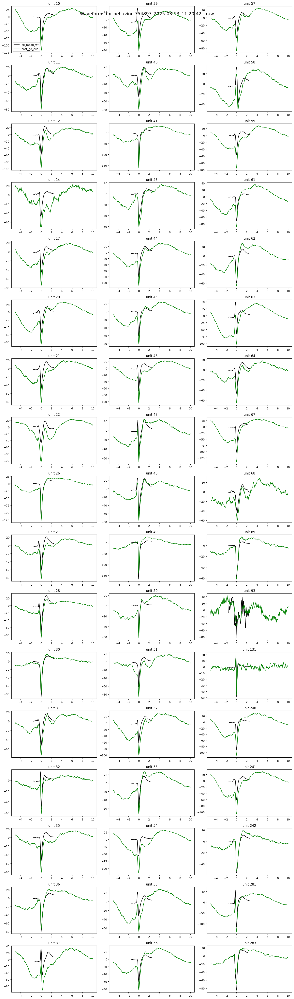

In [127]:
# loop through all unit_ids
# load wf from all three versions
fig = plt.figure(figsize=(5*3, 3*int(np.ceil(len(units_focus)/3))))
gs = gridspec.GridSpec(int(np.ceil(len(units_focus)/3)), 3, figure=fig)
wf_all_raw = analyzer_all_raw.get_extension("templates")
wf_raw = analyzer_gocue_raw.get_extension("templates")

for ind, unit in enumerate(units_focus):
    all_wf_raw = wf_all_raw.get_unit_template(unit_id=unit, operator='average')
    raw_wf = wf_raw.get_unit_template(unit_id=unit, operator='average')

    # infor ptp channel from all_wf
    ptp_channel = np.argmax(np.ptp(all_wf_raw, axis=0))
    # plot all three wf
    ax = fig.add_subplot(gs[ind % int(np.ceil(len(units_focus)/3)), ind // int(np.ceil(len(units_focus)/3))])
    time_all_raw = np.linspace(-1.5, 2.5, all_wf_raw.shape[0])
    time_go_cue = np.linspace(-5, 10, raw_wf.shape[0])
    ax.plot(time_all_raw, all_wf_raw[:, ptp_channel], c = 'k', label='all_mean_wf')
    ax.plot(time_go_cue, raw_wf[:, ptp_channel], c = 'g', label='post_go_cue')
    ax.set_title(f'unit {unit}')
    if ind == 0:
        ax.legend()

plt.suptitle(f'Waveforms for {session} - raw', fontsize=16)
plt.tight_layout()
plt.show()


## check waveforms with short ISI

In [128]:
isi_short_file_bp = os.path.join(session_dir[f'ephys_dir_{data_type}'], 'isishort_bp.zarr')
isi_short_file_raw = os.path.join(session_dir[f'ephys_dir_{data_type}'], 'isishort_raw_fake.zarr')

analyzer_isi_short_bp = si.load(isi_short_file_bp, load_extensions=False)
analyzer_isi_short_raw = si.load(isi_short_file_raw, load_extensions=False)

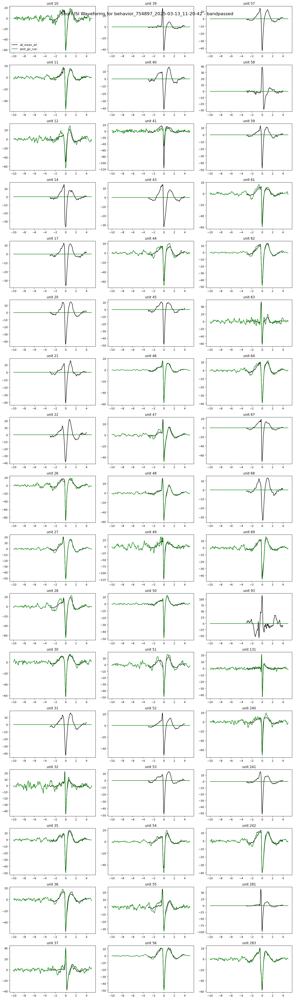

In [129]:
# loop through all unit_ids
# load wf from all three versions
fig = plt.figure(figsize=(5*3, 3*int(np.ceil(len(units_focus)/3))))
gs = gridspec.GridSpec(int(np.ceil(len(units_focus)/3)), 3, figure=fig)
wf_all = analyzer_all.get_extension("templates")
wf_all_raw = analyzer_all_raw.get_extension("templates")
wf_raw = analyzer_isi_short_raw.get_extension("templates")
wf_bp = analyzer_isi_short_bp.get_extension("templates")
for ind, unit in enumerate(units_focus):
    all_wf = wf_all.get_unit_template(unit_id=unit, operator='average')
    # all_wf_raw = wf_all_raw.get_unit_template(unit_id=unit, operator='average')
    raw_wf = wf_raw.get_unit_template(unit_id=unit, operator='average')
    bp_wf = wf_bp.get_unit_template(unit_id=unit, operator='average')
    # infor ptp channel from all_wf
    ptp_channel = np.argmax(np.ptp(all_wf, axis=0))
    # plot all three wf
    ax = fig.add_subplot(gs[ind % int(np.ceil(len(units_focus)/3)), ind // int(np.ceil(len(units_focus)/3))])
    time_all = np.linspace(-3, 4, all_wf.shape[0])
    time_all_raw = np.linspace(-1.5, 2.5, all_wf_raw.shape[0])
    time_isi = np.linspace(-10, 5, raw_wf.shape[0])
    ax.plot(time_all, all_wf[:, ptp_channel], c = 'k', label='all_mean_wf')
    ax.plot(time_isi, bp_wf[:, ptp_channel], c = 'g', label='post_go_cue')
    # ax.plot(time_all_raw, all_wf_raw[:, ptp_channel], c = 'b', label='raw_mean_wf')
    ax.set_title(f'unit {unit}')
    if ind == 0:
        ax.legend()

plt.suptitle(f'Short ISI Waveforms for {session} - bandpassed', fontsize=16)
plt.tight_layout()


In [100]:
# isi_short_file_bp = os.path.join(session_dir[f'ephys_dir_{data_type}'], 'isishort_bp.zarr')
# isi_short_file_raw = os.path.join(session_dir[f'ephys_dir_{data_type}'], 'isishort_raw_fake.zarr')

# analyzer_isi_short_bp = si.load(isi_short_file_bp, load_extensions=False)
# analyzer_isi_short_raw = si.load(isi_short_file_raw, load_extensions=False)

In [132]:
wf_bp_short_isi = analyzer_isi_short_bp.get_extension("waveforms")
random_spikes = analyzer_isi_short_bp.get_extension("random_spikes")
# all_wfs = analyzer_all.get_extension("waveforms")
all_wfs = analyzer_isi_short_bp.get_extension("templates")

In [161]:
fig = plt.figure(figsize=(5*len(units_focus), 40))
gs = gridspec.GridSpec(2, len(units_focus), figure=fig, height_ratios=(1, 25))
for unit_ind in range(len(units_focus)):    
    spike_samples_short = analyzer_isi_short_bp.sorting.get_unit_spike_train(unit_id=units_focus[unit_ind], segment_index=0)
    spike_samples_ori = analyzer_all.sorting.get_unit_spike_train(unit_id=units_focus[unit_ind], segment_index=0)
    unit_waveform = wf_bp_short_isi.get_waveforms_one_unit(unit_id=units_focus[unit_ind])
    template_bp = all_wfs.get_unit_template(unit_id=units_focus[unit_ind], operator='average')
    random_spikes_vector = random_spikes.get_selected_indices_in_spike_train(units_focus[unit_ind], segment_index=0)
    peak_channel = np.argmax(np.ptp(np.squeeze(np.mean(unit_waveform, axis=0)), axis=0), axis=0)
    # isi calculation
    isi_all = []
    for ind in range(np.shape(unit_waveform)[0]):
        # previous spike ind
        sample_number = spike_samples_short[random_spikes_vector[ind]]
        sample_number_pre = spike_samples_ori[np.where(spike_samples_ori < sample_number)[0][-1]]
        isi_all.append(sample_number_pre-sample_number)
    sorted_ind = np.argsort(np.array(isi_all))
    # mean
    time = np.linspace(-10, 5, unit_waveform.shape[1])
    time_all_mean = np.linspace(-3, 4, len(template_bp))
    ax = plt.subplot(gs[1, unit_ind])
    for ind_count, ind in enumerate(sorted_ind):
        ax.plot(time, np.squeeze(unit_waveform[ind, :, peak_channel]) + 250*ind_count, 'k', linewidth=0.5, alpha=0.5);
        ax.plot(time, template_bp[:, peak_channel] + 250*ind_count, 'r', linewidth=0.5);
        # previous spike ind
        peak_ind = 300 + isi_all[ind] 
        signal = unit_waveform[ind, peak_ind, peak_channel]
        ax.scatter(time[peak_ind], unit_waveform[ind, peak_ind, peak_channel] + 250*ind_count, c='r', s=10, marker='x')
    ax.axvline(0, color='k', linestyle='--')

# plt.plot(np.mean(np.squeeze(unit_waveform[:, :, peak_channel]), axis=0), 'r', linewidth=2);

/opt/conda/lib/python3.10/site-packages/numpy/_core/fromnumeric.py:3904: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/conda/lib/python3.10/site-packages/numpy/_core/_methods.py:139: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


In [159]:
unit_waveforms.shape

(14605, 450, 26)

In [82]:
ind

0

In [83]:
spike_samples_short[0]

np.int64(2847606)

In [84]:
spike_samples_ori[0]

np.int64(18680)

In [75]:
unit_waveform.shape

(88, 450, 26)

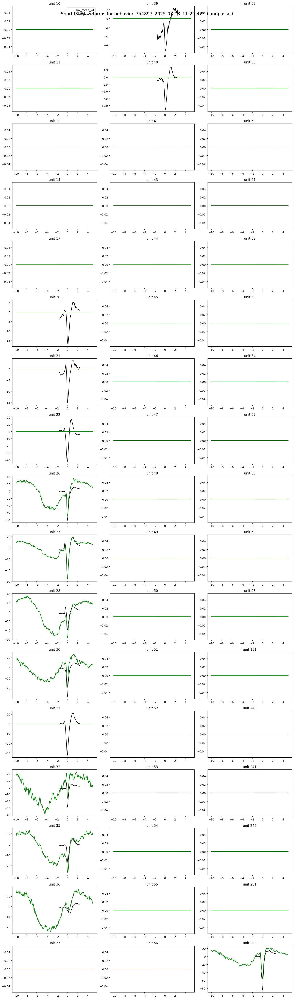

In [16]:
# loop through all unit_ids
# load wf from all three versions
fig = plt.figure(figsize=(5*3, 3*int(np.ceil(len(units_focus)/3))))
gs = gridspec.GridSpec(int(np.ceil(len(units_focus)/3)), 3, figure=fig)
wf_all = analyzer_all.get_extension("templates")
wf_raw = analyzer_isi_short_raw.get_extension("templates")
wf_bp = analyzer_isi_short_bp.get_extension("templates")
for ind, unit in enumerate(units_focus):
    # all_wf = wf_all.get_unit_template(unit_id=unit, operator='average')
    all_wf_raw = wf_all_raw.get_unit_template(unit_id=unit, operator='average')
    raw_wf = wf_raw.get_unit_template(unit_id=unit, operator='average')
    bp_wf = wf_bp.get_unit_template(unit_id=unit, operator='average')
    # infor ptp channel from all_wf
    ptp_channel = np.argmax(np.ptp(all_wf, axis=0))
    # plot all three wf
    ax = fig.add_subplot(gs[ind % int(np.ceil(len(units_focus)/3)), ind // int(np.ceil(len(units_focus)/3))])
    time_all = np.linspace(-3, 4, all_wf.shape[0])
    time_all_raw = np.linspace(-1.5, 2.5, all_wf_raw.shape[0])
    time_isi = np.linspace(-10, 5, raw_wf.shape[0])
    # ax.plot(time_all, all_wf[:, ptp_channel], c = 'k', label='all_mean_wf')
    # ax.plot(time_go_cue, bp_wf[:, ptp_channel], c = 'g', label='post_go_cue')
    ax.plot(time_all_raw, all_wf_raw[:, ptp_channel], c = 'k', label='raw_mean_wf')
    ax.plot(time_isi, raw_wf[:, ptp_channel], c = 'g', label='post_go_cue')
    ax.set_title(f'unit {unit}')
    if ind == 0:
        ax.legend()

plt.suptitle(f'Short ISI Waveforms for {session} - bandpassed', fontsize=16)
plt.tight_layout()


In [ ]:
all_wf_raw = analyzer_isi_short_bp.get_extension("waveforms")
unit_waveforms = all_wf_raw.get_data()

In [ ]:
unit_waveforms.shape

(1, 450, 26)

In [ ]:
random_spikes = analyzer_gocue_raw.get_extension("random_spikes")
random_spikes_vector = random_spikes.get_random_spikes()